In [0]:
import pandas as pd
import numpy as np
import os
import keras
import matplotlib.pyplot as plt
from keras.layers import Dense,GlobalAveragePooling2D
from keras.applications import MobileNet
from keras.preprocessing import image
from keras.applications.mobilenet import preprocess_input
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.optimizers import Adam

Using TensorFlow backend.


In [0]:
!pip install -U -q kaggle
!mkdir -p ~/.kaggle


from google.colab import files
files.upload()

In [0]:
!cp kaggle.json ~/.kaggle
!kaggle datasets download -d paultimothymooney/chest-xray-pneumonia

 99% 1.14G/1.15G [00:26<00:00, 31.0MB/s]
100% 1.15G/1.15G [00:26<00:00, 46.0MB/s]


In [0]:
!ls

chest-xray-pneumonia.zip  kaggle.json  sample_data


In [0]:
!unzip chest-xray-pneumonia.zip

Archive:  chest-xray-pneumonia.zip
  inflating: chest_xray.zip          


In [0]:
!unzip chest_xray.zip

Archive:  chest_xray.zip
   creating: chest_xray/
  inflating: chest_xray/.DS_Store    
   creating: __MACOSX/
   creating: __MACOSX/chest_xray/
  inflating: __MACOSX/chest_xray/._.DS_Store  
   creating: chest_xray/test/
  inflating: chest_xray/test/.DS_Store  
   creating: __MACOSX/chest_xray/test/
  inflating: __MACOSX/chest_xray/test/._.DS_Store  
   creating: chest_xray/test/PNEUMONIA/
  inflating: chest_xray/test/PNEUMONIA/person147_bacteria_706.jpeg  
   creating: __MACOSX/chest_xray/test/PNEUMONIA/
  inflating: __MACOSX/chest_xray/test/PNEUMONIA/._person147_bacteria_706.jpeg  
  inflating: chest_xray/test/PNEUMONIA/person100_bacteria_482.jpeg  
  inflating: __MACOSX/chest_xray/test/PNEUMONIA/._person100_bacteria_482.jpeg  
  inflating: chest_xray/test/PNEUMONIA/person78_bacteria_382.jpeg  
  inflating: __MACOSX/chest_xray/test/PNEUMONIA/._person78_bacteria_382.jpeg  
  inflating: chest_xray/test/PNEUMONIA/person124_bacteria_589.jpeg  
  inflating: __MACOSX/chest_xray/test/PNEUM

In [0]:
import os
os.listdir('chest_xray/train/')

['NORMAL', 'PNEUMONIA', '.DS_Store']

In [0]:
os.listdir('chest_xray/')

['train', 'val', '.DS_Store', 'test']

In [0]:
image_gen = ImageDataGenerator()

train_gen = image_gen.flow_from_directory('chest_xray/train/',
                                         target_size=(224,224),
                                         color_mode = 'rgb',
                                         batch_size=32,
                                         shuffle=True,
                                         class_mode = 'categorical'
                                         )

image_gen_v = ImageDataGenerator()

val_gen = image_gen_v.flow_from_directory('chest_xray/val/',
                                         target_size=(224,224),
                                         color_mode = 'rgb',
                                         batch_size=32,
                                         shuffle=True,
                                         class_mode = 'categorical'
                                         )

image_gen_t = ImageDataGenerator()

val_gen = image_gen_t.flow_from_directory('chest_xray/test/',
                                         target_size=(224,224),
                                         color_mode = 'rgb',
                                         batch_size=32,
                                         shuffle=True,
                                         class_mode = 'categorical'
                                         )

train_gen.class_indices
dict = {0:'Normal',1:'Pneumoniua'}

Found 5216 images belonging to 2 classes.
Found 16 images belonging to 2 classes.
Found 624 images belonging to 2 classes.


In [0]:
model = MobileNet(weights='imagenet',include_top=False,input_shape=(224,224,3))

W0902 16:21:44.928821 139739228002176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:66: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0902 16:21:44.970187 139739228002176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:541: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0902 16:21:44.983706 139739228002176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4432: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0902 16:21:45.023529 139739228002176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:190: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0902 16:21:45.024682 1397392280

17227776/17225924 [==============================] - 1s 0us/step


In [0]:
model.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 225, 225, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32

In [0]:
from keras.layers import *
av = GlobalAveragePooling2D()(model.output)
fc1 = Dense(512,activation='relu')(av)
d1 = Dropout(0.25)(fc1)
fc2 = Dense(128,activation='relu')(d1)
fc3 = Dense(2,activation='softmax')(fc2)

model_new = Model(input=model.input,output=fc3)
model_new.summary()

W0902 16:21:55.204025 139739228002176 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3733: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
conv1_pad (ZeroPadding2D)    (None, 225, 225, 3)       0         
_________________________________________________________________
conv1 (Conv2D)               (None, 112, 112, 32)      864       
_________________________________________________________________
conv1_bn (BatchNormalization (None, 112, 112, 32)      128       
_________________________________________________________________
conv1_relu (ReLU)            (None, 112, 112, 32)      0         
_________________________________________________________________
conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)      288       
_________________________________________________________________
conv_dw_1_bn (BatchNormaliza (None, 112, 112, 32)      128 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: Update your `Model` call to the Keras 2 API: `Model(inputs=Tensor("in..., outputs=Tensor("de...)`
  


In [0]:
for i in range(len(model_new.layers)):
  print(str(i)+" "+str(model_new.layers[i]))

0 <keras.engine.input_layer.InputLayer object at 0x7f176f688198>
1 <keras.layers.convolutional.ZeroPadding2D object at 0x7f1738f1b048>
2 <keras.layers.convolutional.Conv2D object at 0x7f1738f1b080>
3 <keras.layers.normalization.BatchNormalization object at 0x7f1738f1b5f8>
4 <keras.layers.advanced_activations.ReLU object at 0x7f1738f1bcc0>
5 <keras.layers.convolutional.DepthwiseConv2D object at 0x7f1736a4a438>
6 <keras.layers.normalization.BatchNormalization object at 0x7f1738f1b6d8>
7 <keras.layers.advanced_activations.ReLU object at 0x7f173649ff60>
8 <keras.layers.convolutional.Conv2D object at 0x7f173644ef28>
9 <keras.layers.normalization.BatchNormalization object at 0x7f173640d860>
10 <keras.layers.advanced_activations.ReLU object at 0x7f17363ccef0>
11 <keras.layers.convolutional.ZeroPadding2D object at 0x7f17363bf9b0>
12 <keras.layers.convolutional.DepthwiseConv2D object at 0x7f17363bfcc0>
13 <keras.layers.normalization.BatchNormalization object at 0x7f17362efa90>
14 <keras.layers.

In [0]:
for i in range(81):
  model_new.layers[i].trainable = False
for i in range(92):
  model_new.layers[i].trainable = True

In [0]:
model_new.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])

W0902 16:21:55.348227 139739228002176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:793: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



In [0]:
model_new.fit_generator(generator=train_gen,
                       epochs=7,
                       steps_per_epoch = 163,
                       validation_data = val_gen,
                       validation_steps = 1
                       )

W0902 16:22:01.565828 139739228002176 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Epoch 1/7
163/163 [==============================] - 87s 534ms/step - loss: 0.1080 - acc: 0.9603 - val_loss: 0.0396 - val_acc: 1.0000
Epoch 2/7
163/163 [==============================] - 78s 477ms/step - loss: 0.0470 - acc: 0.9833 - val_loss: 0.0177 - val_acc: 1.0000
Epoch 3/7
163/163 [==============================] - 78s 480ms/step - loss: 0.0550 - acc: 0.9826 - val_loss: 0.2965 - val_acc: 0.9375
Epoch 4/7
163/163 [==============================] - 78s 480ms/step - loss: 0.0314 - acc: 0.9898 - val_loss: 0.0151 - val_acc: 1.0000
Epoch 5/7
163/163 [==============================] - 78s 481ms/step - loss: 0.0195 - acc: 0.9941 - val_loss: 0.0070 - val_acc: 1.0000
Epoch 6/7
163/163 [==============================] - 78s 477ms/step - loss: 0.0309 - acc: 0.9889 - val_loss: 2.2354e-04 - val_acc: 1.0000
Epoch 7/7
163/163 [==============================] - 78s 478ms/step - loss: 0.0235 - acc: 0.9919 - val_loss: 0.0684 - val_acc: 1.0000


Normal


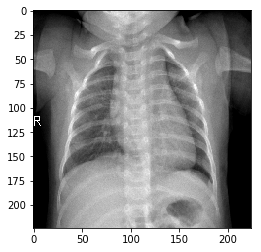

In [0]:
img = image.load_img('chest_xray/train/NORMAL/NORMAL2-IM-0690-0001.jpeg',target_size=(224,224,3))
plt.imshow(img)
test = image.img_to_array(img)
x = np.expand_dims(test, axis=0)
print(dict[np.argmax(model_new.predict(x))])

In [0]:
scores = model_new.evaluate_generator(test_gen,624) 
print("Accuracy = ", scores[1])

Accuracy =  0.7453779786359901


In [0]:
!wget https://drive.google.com/file/d/0B93dIJ5ETl04aHJDUzliRlJoZ0VZNmNiemFFOTB6TFJfdVVN/view?usp=sharing

In [0]:
from google.colab import files
files.upload()

{}

In [0]:
!ls

In [0]:
img = image.load_img('P_20190831_205329_vHDR_Auto.jpg',target_size=(224,224,3))
plt.imshow(img)
test = image.img_to_array(img)
x = np.expand_dims(test, axis=0)
print(dict[np.argmax(model_new.predict(x))])

In [0]:
!pip install -U -q PyDrive

     |████████████████████████████████| 993kB 6.4MB/s 


In [0]:
from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

In [0]:
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

In [0]:
model_new.save('model.h5')    
model_file = drive.CreateFile({'title' : 'model.h5'})
model_file.SetContentFile('model.h5')
model_file.Upload()

In [0]:
drive.CreateFile({'id': model_file.get('id')})

GoogleDriveFile({'id': '1c76FVdgWb2rNAa6WyUmyUz9KlLWXKk1V'})

In [0]:
from keras.models import load_model
model = load_model('model.h5')

In [0]:
from google.colab import files
files.upload()

Saving P_20190901_094808_SRES.jpg to P_20190901_094808_SRES.jpg


{'P_20190901_094808_SRES.jpg': b'\xff\xd8\xff\xe1f"Exif\x00\x00MM\x00*\x00\x00\x00\x08\x00\x0c\x01\x00\x00\x04\x00\x00\x00\x01\x00\x00$`\x01\x10\x00\x02\x00\x00\x00\x0c\x00\x00\x00\x9e\x01\x01\x00\x04\x00\x00\x00\x01\x00\x00\x1bH\x011\x00\x02\x00\x00\x00\x08\x00\x00\x00\xaa\x012\x00\x02\x00\x00\x00\x14\x00\x00\x00\xb2\x02\x13\x00\x03\x00\x00\x00\x01\x00\x01\x00\x00\x87i\x00\x04\x00\x00\x00\x01\x00\x00\x00\xdb\x01(\x00\x03\x00\x00\x00\x01\x00\x02\x00\x00\x88%\x00\x04\x00\x00\x00\x01\x00\x00;\xd0\x01\x1a\x00\x05\x00\x00\x00\x01\x00\x00\x00\xc6\x01\x1b\x00\x05\x00\x00\x00\x01\x00\x00\x00\xce\x01\x0f\x00\x02\x00\x00\x00\x05\x00\x00\x00\xd6\x00\x00<%ASUS_Z017DB\x00Android\x002019:09:01 09:48:08\x00\x00\x00\x00H\x00\x00\x00\x01\x00\x00\x00H\x00\x00\x00\x01asus\x00\x00\x1e\x92|\x00\x07\x00\x008\xec\x00\x00\x02I\x88\'\x00\x03\x00\x00\x00\x01\x01\x95\x00\x00\x88"\x00\x03\x00\x00\x00\x01\x00\x00\x00\x00\x82\x9d\x00\x05\x00\x00\x00\x01\x00\x00;5\x82\x9a\x00\x05\x00\x00\x00\x01\x00\x00;=\xa2\x17\x

Pneumoniua


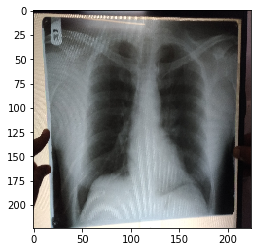

In [0]:
img = image.load_img('P_20190901_094808_SRES.jpg',target_size=(224,224,3))
plt.imshow(img)
test = image.img_to_array(img)
x = np.expand_dims(test, axis=0)
print(dict[np.argmax(model.predict(x))])